# Import các thư viện

In [1]:
import matplotlib.pyplot as plt
from sklearn import datasets
import pandas as pd
import numpy as np
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from sklearn.preprocessing import LabelEncoder
from ucimlrepo import fetch_ucirepo
from graphviz import Source
from IPython.display import display, Image
import seaborn as sns

# Wine Quality Dataset - Multi-class Classification

This notebook uses the UCI Wine Quality dataset for classifying wine samples into quality levels (0-10) based on physicochemical properties (acidity, alcohol, etc.).

- Dataset link: https://archive.ics.uci.edu/dataset/186/wine+quality
- Number of samples: 4898
- Number of features: physicochemical properties
- Target: Wine quality score (integer from 0 to 10)
- This is a multi-class classification problem.

### 1. Train và test dataset

In [2]:
# Fetch Wine Quality dataset (id=186)
wine_quality = fetch_ucirepo(id=186)

# Data (as pandas DataFrames)
X = wine_quality.data.features
y = wine_quality.data.targets

# Kiểm tra thông tin tổng quan về dữ liệu
print("Metadata:")
print(wine_quality.metadata)

print("\nVariable Information:")
print(wine_quality.variables)

# Kiểm tra số dòng, số cột và các giá trị thiếu (nếu có)
print("\nShape of X:", X.shape)
print("Shape of y:", y.shape)
print("\nMissing values in X:\n", X.isnull().sum())
print("Missing values in y:\n", y.isnull().sum())

# Extract features and labels
features = wine_quality.data.features.values
labels = np.ravel(wine_quality.data.targets)

# Handle missing values
data = pd.concat([pd.DataFrame(features, columns=wine_quality.data.features.columns), pd.Series(labels, name='num')], axis=1)
data = data.dropna().reset_index(drop=True)
features = data.iloc[:, :-1].values
labels = data.iloc[:, -1].values

# Encode the target variable (multi-class: 0-10)
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
labels_encoded = label_encoder.fit_transform(labels)

# Lấy tên các lớp (class_names) đúng với nhãn thực tế
class_names = [str(cls) for cls in label_encoder.classes_]

# Define train/test split proportions
split_ratios = [(0.4, 0.6), (0.6, 0.4), (0.8, 0.2), (0.9, 0.1)]

subsets = []

for split_ratio in split_ratios:
    feature_train, feature_test, label_train, label_test = train_test_split(
        features, labels_encoded, test_size=split_ratio[1], random_state=42, stratify=labels_encoded
    )
    
    subsets.append({
        'feature_train': feature_train,
        'label_train': label_train,
        'feature_test': feature_test,
        'label_test': label_test
    })

Metadata:
{'uci_id': 186, 'name': 'Wine Quality', 'repository_url': 'https://archive.ics.uci.edu/dataset/186/wine+quality', 'data_url': 'https://archive.ics.uci.edu/static/public/186/data.csv', 'abstract': 'Two datasets are included, related to red and white vinho verde wine samples, from the north of Portugal. The goal is to model wine quality based on physicochemical tests (see [Cortez et al., 2009], http://www3.dsi.uminho.pt/pcortez/wine/).', 'area': 'Business', 'tasks': ['Classification', 'Regression'], 'characteristics': ['Multivariate'], 'num_instances': 4898, 'num_features': 11, 'feature_types': ['Real'], 'demographics': [], 'target_col': ['quality'], 'index_col': None, 'has_missing_values': 'no', 'missing_values_symbol': None, 'year_of_dataset_creation': 2009, 'last_updated': 'Wed Nov 15 2023', 'dataset_doi': '10.24432/C56S3T', 'creators': ['Paulo Cortez', 'A. Cerdeira', 'F. Almeida', 'T. Matos', 'J. Reis'], 'intro_paper': {'ID': 252, 'type': 'NATIVE', 'title': 'Modeling wine p

In [3]:
print("Số lượng mẫu trong dataset:", len(wine_quality.data.features))

Số lượng mẫu trong dataset: 6497


In [4]:
print("Tên các đặc trưng:")
print(wine_quality.data.features.columns.tolist())

Tên các đặc trưng:
['fixed_acidity', 'volatile_acidity', 'citric_acid', 'residual_sugar', 'chlorides', 'free_sulfur_dioxide', 'total_sulfur_dioxide', 'density', 'pH', 'sulphates', 'alcohol']


In [ ]:
print("Số lượng features:", len(wine_quality.data.features.columns))

Số lượng features: 11


### 2. Visualization

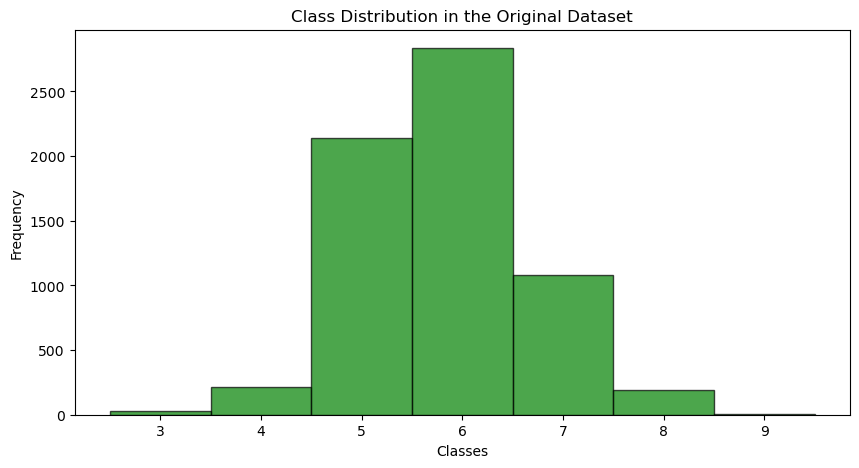

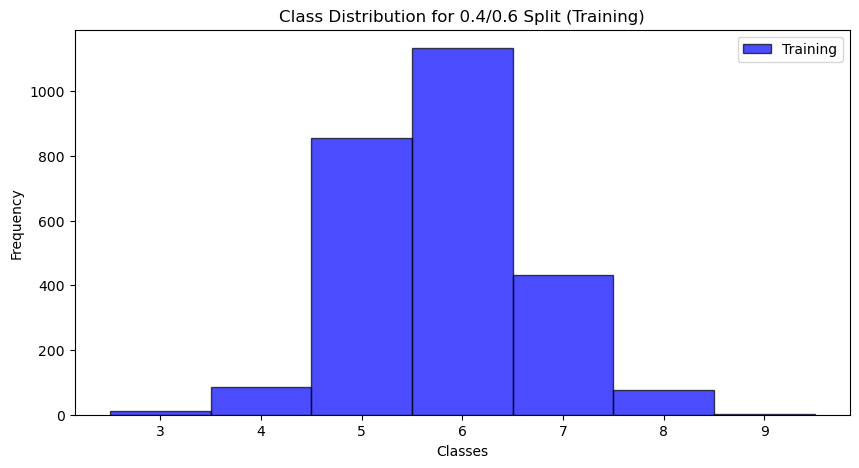

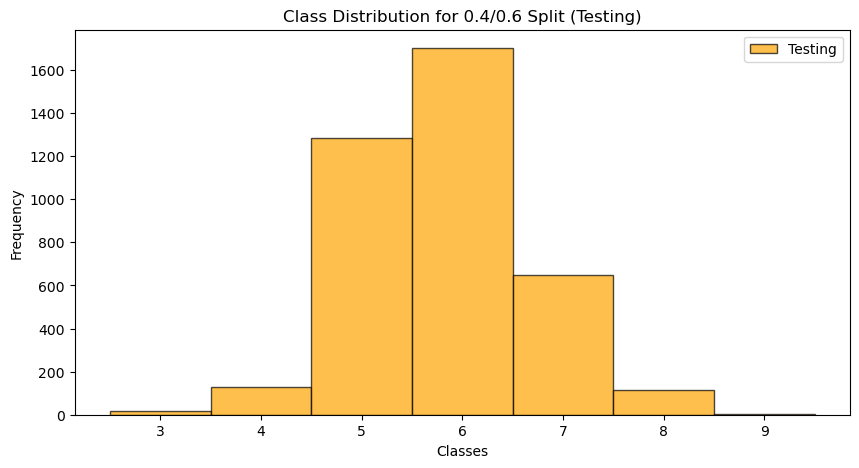

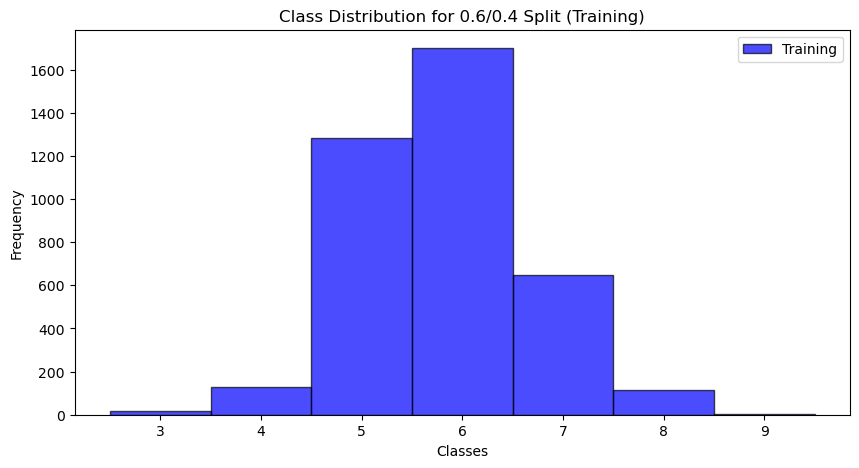

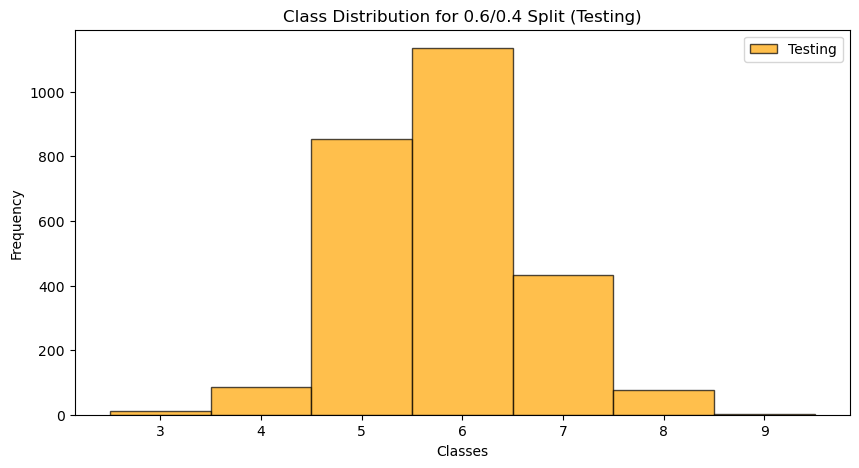

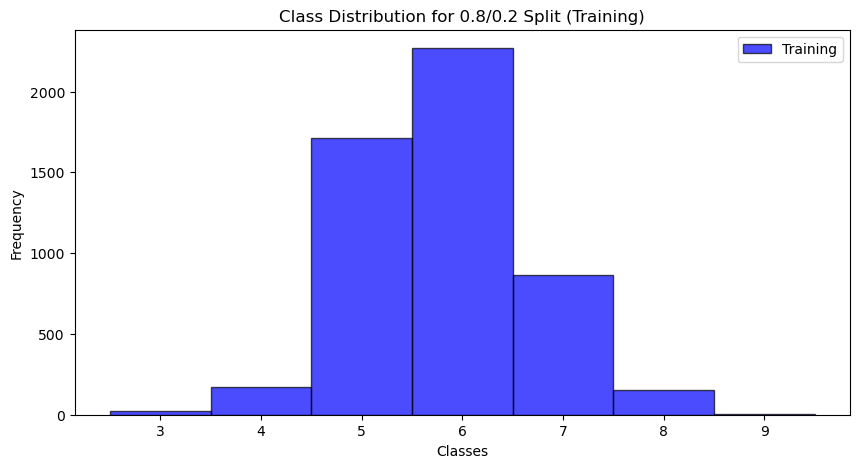

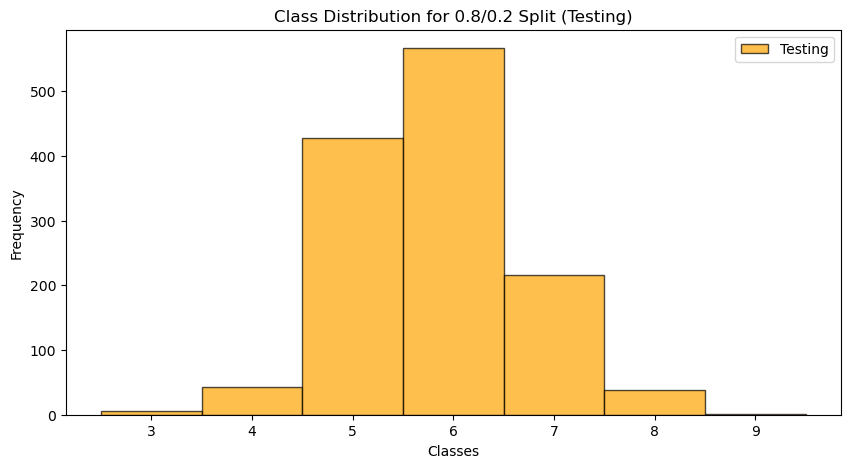

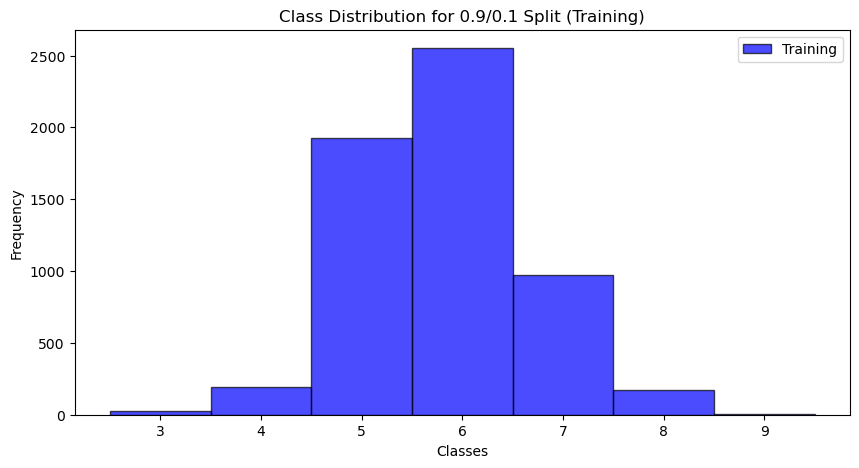

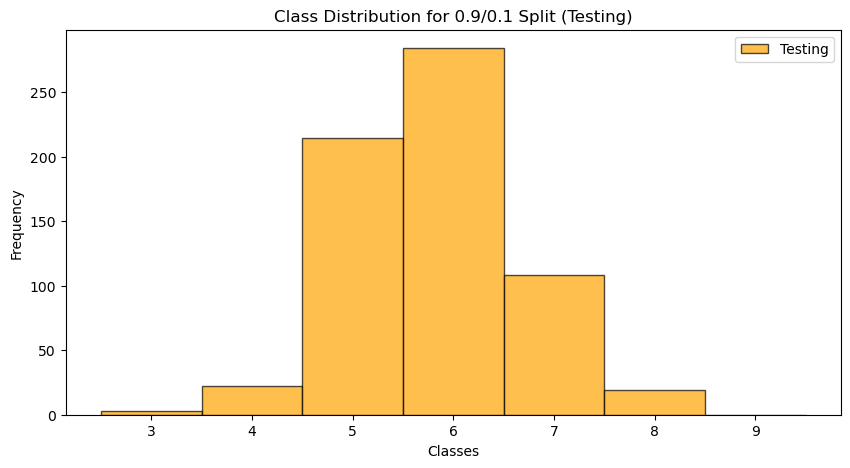

In [5]:
# Visualize the class distribution in the original dataset
plt.figure(figsize=(10, 5))
bins = np.arange(len(np.unique(labels_encoded)) + 1) - 0.5
plt.hist(labels_encoded, bins=bins, color="green", alpha=0.7, edgecolor="black")
plt.title("Class Distribution in the Original Dataset")
plt.xlabel("Classes")
plt.ylabel("Frequency")
plt.xticks(np.arange(len(class_names)), class_names)
plt.show()

# Visualize distributions for each train/test split
for i in range(len(subsets)):
    label_train = subsets[i]['label_train']
    label_test = subsets[i]['label_test']

    bins = np.arange(len(np.unique(labels_encoded)) + 1) - 0.5
    
    plt.figure(figsize=(10, 5))
    plt.hist(label_train, bins=bins, color="blue", alpha=0.7, edgecolor="black", label="Training")
    plt.title(f"Class Distribution for {split_ratios[i][0]}/{split_ratios[i][1]} Split (Training)")
    plt.xlabel("Classes")
    plt.ylabel("Frequency")
    plt.xticks(np.arange(len(class_names)), class_names)
    plt.legend()
    plt.show()
    
    plt.figure(figsize=(10, 5))
    plt.hist(label_test, bins=bins, color="orange", alpha=0.7, edgecolor="black", label="Testing")
    plt.title(f"Class Distribution for {split_ratios[i][0]}/{split_ratios[i][1]} Split (Testing)")
    plt.xlabel("Classes")
    plt.ylabel("Frequency")
    plt.xticks(np.arange(len(class_names)), class_names)
    plt.legend()
    plt.show()

### 3. Train model

In [6]:
# Train and evaluate the Decision Tree model using Entropy (Information Gain)
models = []
for i, subset in enumerate(subsets):
    feature_train = subset['feature_train']
    label_train = subset['label_train']
    # model = DecisionTreeClassifier(criterion='entropy', random_state=42, max_depth=5, class_weight='balanced')
    model = DecisionTreeClassifier(criterion='entropy', random_state=42)
    model.fit(feature_train, label_train)
    models.append(model)

### 4. Visualization

Decision tree of the model trained with split ratio 0.4/0.6



(process:22568): Pango-CRITICAL **: 17:31:47.843: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:22568): Pango-CRITICAL **: 17:31:47.845: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:22568): Pango-CRITICAL **: 17:31:47.845: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:22568): Pango-CRITICAL **: 17:31:47.845: pango_font_description_get_family: assertion 'desc != NULL' failed
dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.519213 to fit


Decision tree of the model trained with split ratio 0.6/0.4



(process:14412): Pango-CRITICAL **: 17:31:54.705: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:14412): Pango-CRITICAL **: 17:31:54.705: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:14412): Pango-CRITICAL **: 17:31:54.705: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:14412): Pango-CRITICAL **: 17:31:54.705: pango_font_description_get_family: assertion 'desc != NULL' failed
dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.347355 to fit


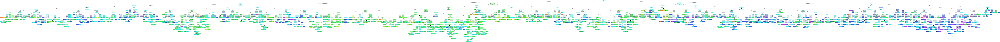

Decision tree of the model trained with split ratio 0.8/0.2



(process:1432): Pango-CRITICAL **: 17:31:58.620: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:1432): Pango-CRITICAL **: 17:31:58.620: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:1432): Pango-CRITICAL **: 17:31:58.620: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:1432): Pango-CRITICAL **: 17:31:58.620: pango_font_description_get_family: assertion 'desc != NULL' failed
dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.282506 to fit


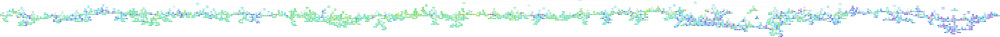

Decision tree of the model trained with split ratio 0.9/0.1



(process:23420): Pango-CRITICAL **: 17:32:02.935: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:23420): Pango-CRITICAL **: 17:32:02.935: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:23420): Pango-CRITICAL **: 17:32:02.935: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:23420): Pango-CRITICAL **: 17:32:02.935: pango_font_description_get_family: assertion 'desc != NULL' failed
dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.259917 to fit


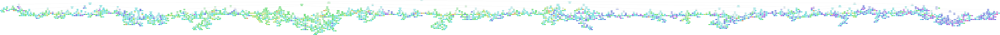

In [7]:
for i in range(len(models)):
    print(f"Decision tree of the model trained with split ratio {split_ratios[i][0]}/{split_ratios[i][1]}")
    # Export the decision tree to DOT format
    dot_data = export_graphviz(
        models[i],  # Use the correct model from the list
        out_file=None,  # Don't save to file, we will use the source in memory
        feature_names=wine_quality.data.features.columns.values,  # Use Wine Quality feature names
        class_names=class_names,  # Convert class names to strings
        filled=True,
        rounded=True,
        special_characters=True,
        fontname="Arial"
    )
    
    # Render the DOT file with Graphviz
    graph = Source(dot_data)
    # Visualize the tree
    graph.render(f"./tree/tree1/tree_{split_ratios[i][0]}_{split_ratios[i][1]}", 
                 format='png', 
                 cleanup=True)
    display(Image(f"./tree/tree1/tree_{split_ratios[i][0]}_{split_ratios[i][1]}.png"))

### 5. Đánh giá Decision Tree

Split (0.4, 0.6) Class Distribution in Test Set:
3    1702
2    1283
4     647
1     130
5     116
0      18
6       3
Name: count, dtype: int64
Classification Report for 0.4/0.6 Split:
              precision    recall  f1-score   support

           3       0.00      0.00      0.00        18
           4       0.12      0.14      0.13       130
           5       0.60      0.56      0.58      1283
           6       0.58      0.58      0.58      1702
           7       0.44      0.49      0.47       647
           8       0.20      0.19      0.20       116
           9       0.00      0.00      0.00         3

    accuracy                           0.53      3899
   macro avg       0.28      0.28      0.28      3899
weighted avg       0.54      0.53      0.53      3899



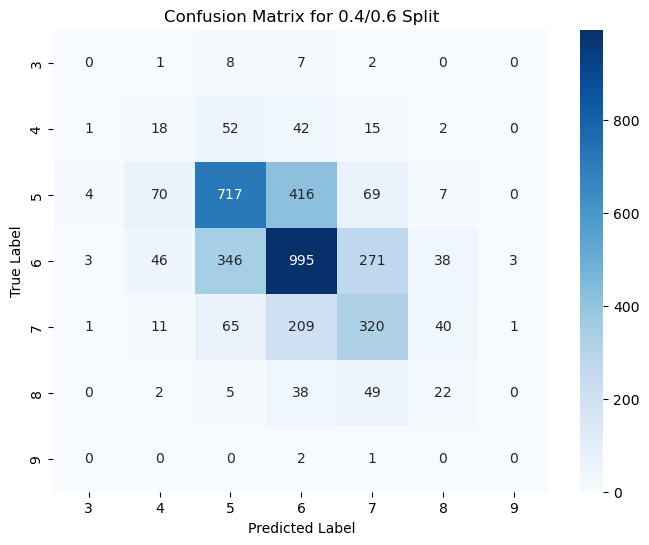

Split (0.6, 0.4) Class Distribution in Test Set:
3    1135
2     855
4     432
1      86
5      77
0      12
6       2
Name: count, dtype: int64
Classification Report for 0.6/0.4 Split:
              precision    recall  f1-score   support

           3       0.00      0.00      0.00        12
           4       0.24      0.23      0.24        86
           5       0.62      0.61      0.62       855
           6       0.62      0.61      0.61      1135
           7       0.50      0.54      0.52       432
           8       0.39      0.44      0.41        77
           9       0.00      0.00      0.00         2

    accuracy                           0.58      2599
   macro avg       0.34      0.35      0.34      2599
weighted avg       0.58      0.58      0.58      2599



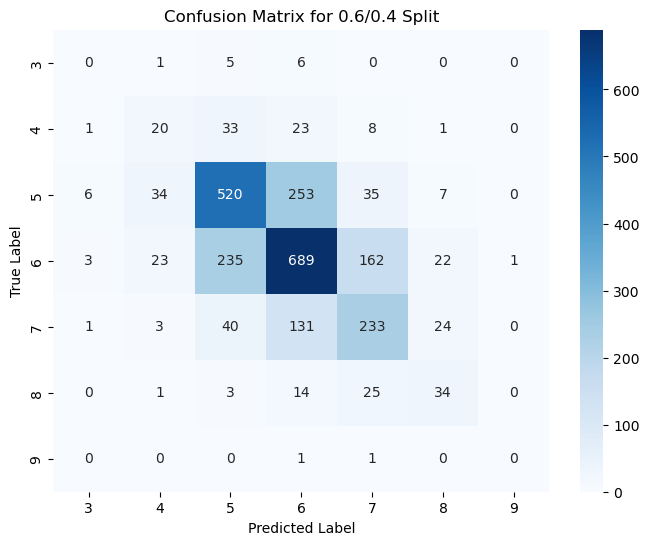

Split (0.8, 0.2) Class Distribution in Test Set:
3    567
2    428
4    216
1     43
5     39
0      6
6      1
Name: count, dtype: int64
Classification Report for 0.8/0.2 Split:
              precision    recall  f1-score   support

           3       0.00      0.00      0.00         6
           4       0.19      0.16      0.18        43
           5       0.64      0.64      0.64       428
           6       0.64      0.62      0.63       567
           7       0.56      0.61      0.58       216
           8       0.35      0.36      0.35        39
           9       0.00      0.00      0.00         1

    accuracy                           0.60      1300
   macro avg       0.34      0.34      0.34      1300
weighted avg       0.60      0.60      0.60      1300



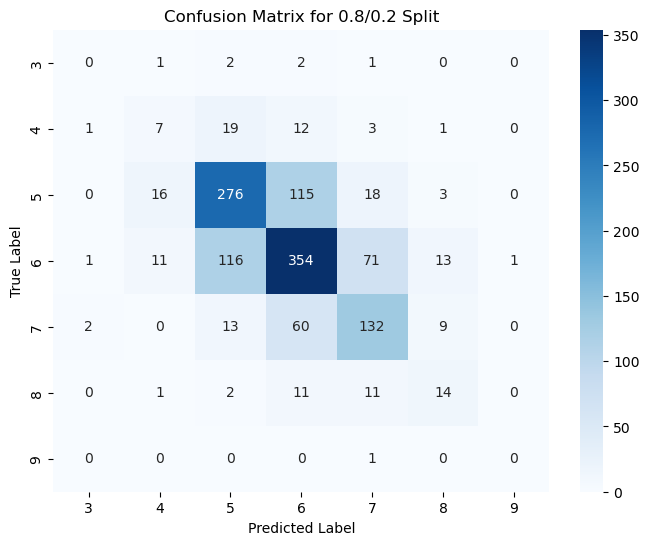

Split (0.9, 0.1) Class Distribution in Test Set:
3    284
2    214
4    108
1     22
5     19
0      3
Name: count, dtype: int64
Classification Report for 0.9/0.1 Split:
              precision    recall  f1-score   support

           3       0.00      0.00      0.00         3
           4       0.23      0.14      0.17        22
           5       0.69      0.64      0.66       214
           6       0.66      0.66      0.66       284
           7       0.55      0.65      0.59       108
           8       0.31      0.42      0.36        19
           9       0.00      0.00      0.00         0

    accuracy                           0.62       650
   macro avg       0.35      0.36      0.35       650
weighted avg       0.62      0.62      0.62       650



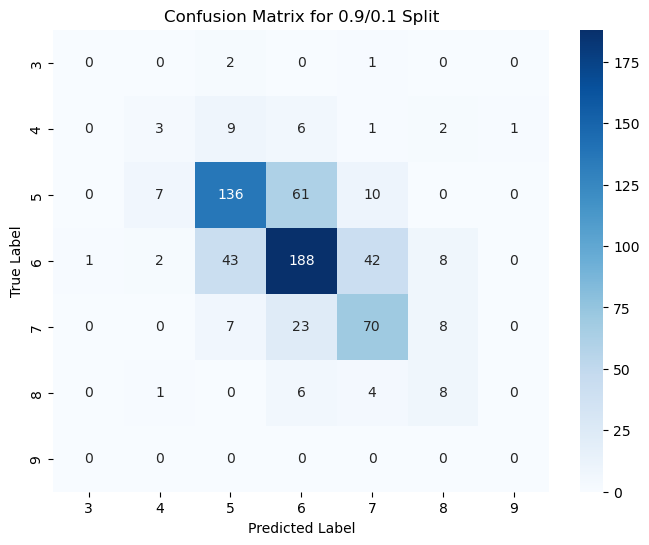

In [8]:
# For each model and split, make predictions, generate a report, and confusion matrix
for i, subset in enumerate(subsets):
    feature_train = subset['feature_train']
    label_train = subset['label_train']
    feature_test = subset['feature_test']
    label_test = subset['label_test']
    
    # Make predictions
    label_pred = models[i].predict(feature_test)
    
    # Print class distribution in test set
    print(f"Split {split_ratios[i]} Class Distribution in Test Set:")
    print(pd.Series(label_test).value_counts())
    
    # Generate classification report
    print(f"Classification Report for {split_ratios[i][0]}/{split_ratios[i][1]} Split:")
    print(classification_report(label_test, label_pred, target_names=class_names, zero_division=0))
    
    # Generate confusion matrix
    cm = confusion_matrix(label_test, label_pred)
    
    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=class_names, yticklabels=class_names)
    plt.title(f"Confusion Matrix for {split_ratios[i][0]}/{split_ratios[i][1]} Split")
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.show()

### 6. Độ sâu (depth) và độ chính xác (accuracy) của Decision Tree

#### 6.1 Visualization

Decision tree of the model trained with split ratio 80/20 and max depth None



(process:27088): Pango-CRITICAL **: 17:32:08.624: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:27088): Pango-CRITICAL **: 17:32:08.624: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:27088): Pango-CRITICAL **: 17:32:08.624: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:27088): Pango-CRITICAL **: 17:32:08.624: pango_font_description_get_family: assertion 'desc != NULL' failed
dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.186628 to fit


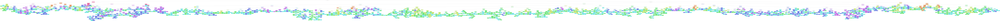

Accuracy for max_depth None: 0.5444
Decision tree of the model trained with split ratio 80/20 and max depth 2



(process:2076): Pango-CRITICAL **: 17:32:11.979: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:2076): Pango-CRITICAL **: 17:32:11.979: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:2076): Pango-CRITICAL **: 17:32:11.979: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:2076): Pango-CRITICAL **: 17:32:11.979: pango_font_description_get_family: assertion 'desc != NULL' failed


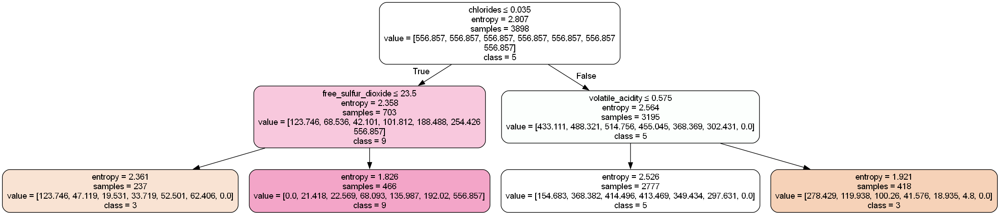

Accuracy for max_depth 2: 0.2462
Decision tree of the model trained with split ratio 80/20 and max depth 3



(process:13100): Pango-CRITICAL **: 17:32:12.739: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:13100): Pango-CRITICAL **: 17:32:12.739: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:13100): Pango-CRITICAL **: 17:32:12.739: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:13100): Pango-CRITICAL **: 17:32:12.739: pango_font_description_get_family: assertion 'desc != NULL' failed


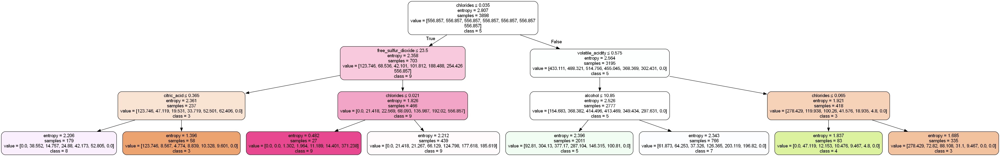

Accuracy for max_depth 3: 0.2882
Decision tree of the model trained with split ratio 80/20 and max depth 4



(process:7980): Pango-CRITICAL **: 17:32:13.584: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:7980): Pango-CRITICAL **: 17:32:13.584: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:7980): Pango-CRITICAL **: 17:32:13.584: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:7980): Pango-CRITICAL **: 17:32:13.584: pango_font_description_get_family: assertion 'desc != NULL' failed


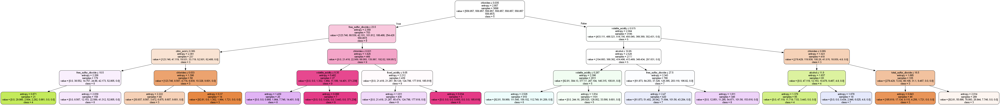

Accuracy for max_depth 4: 0.3213
Decision tree of the model trained with split ratio 80/20 and max depth 5



(process:2708): Pango-CRITICAL **: 17:32:14.618: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:2708): Pango-CRITICAL **: 17:32:14.618: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:2708): Pango-CRITICAL **: 17:32:14.618: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:2708): Pango-CRITICAL **: 17:32:14.618: pango_font_description_get_family: assertion 'desc != NULL' failed


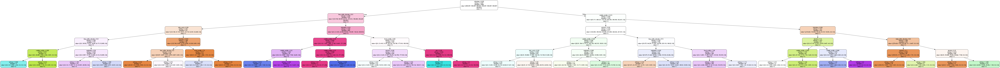

Accuracy for max_depth 5: 0.2324
Decision tree of the model trained with split ratio 80/20 and max depth 6



(process:10204): Pango-CRITICAL **: 17:32:16.070: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:10204): Pango-CRITICAL **: 17:32:16.071: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:10204): Pango-CRITICAL **: 17:32:16.071: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:10204): Pango-CRITICAL **: 17:32:16.071: pango_font_description_get_family: assertion 'desc != NULL' failed


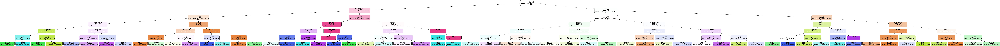

Accuracy for max_depth 6: 0.2289
Decision tree of the model trained with split ratio 80/20 and max depth 7



(process:21600): Pango-CRITICAL **: 17:32:18.145: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:21600): Pango-CRITICAL **: 17:32:18.145: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:21600): Pango-CRITICAL **: 17:32:18.145: pango_font_description_get_family: assertion 'desc != NULL' failed

(process:21600): Pango-CRITICAL **: 17:32:18.145: pango_font_description_get_family: assertion 'desc != NULL' failed
dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.856654 to fit


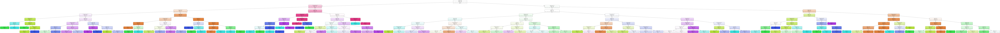

Accuracy for max_depth 7: 0.3297


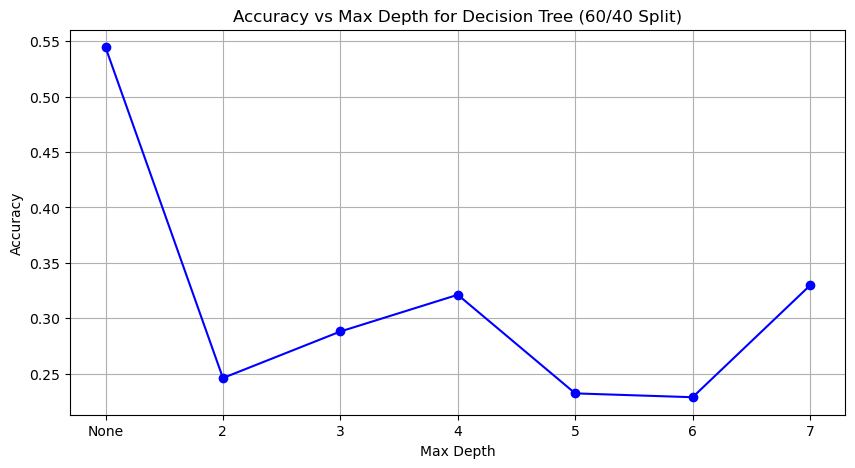

In [9]:
# Select the 80/20 split (index 2 in split_ratios)
subset_80_20 = subsets[1]
feature_train_80_20 = subset_80_20['feature_train']
label_train_80_20 = subset_80_20['label_train']
feature_test_80_20 = subset_80_20['feature_test']
label_test_80_20 = subset_80_20['label_test']

accuracy_scores = []
depths = [None, 2, 3, 4, 5, 6, 7]

for depth in depths:
    model = DecisionTreeClassifier(criterion='entropy', random_state=42, max_depth=depth, class_weight='balanced')
    model.fit(feature_train_80_20, label_train_80_20)

    print(f"Decision tree of the model trained with split ratio 80/20 and max depth {depth}")
    # Export the decision tree to DOT format
    dot_data = export_graphviz(
        model,
        out_file=None,
        feature_names=wine_quality.data.features.columns,
        class_names=class_names,
        filled=True,
        rounded=True,
        special_characters=True,
        fontname="Arial"
    )
    
    # Render the DOT file with Graphviz
    graph = Source(dot_data)
    # Visualize the tree
    graph.render(f"./tree_80_20/tree1/tree_{depth}", 
                 format='png', 
                 cleanup=True)
    display(Image(filename=f"./tree_80_20/tree1/tree_{depth}.png"))

    # Make predictions and calculate accuracy
    pred = model.predict(feature_test_80_20)
    accuracy = accuracy_score(label_test_80_20, pred)
    print(f"Accuracy for max_depth {depth}: {accuracy:.4f}")
    accuracy_scores.append(accuracy)

# Plot the results
depths_for_plot = [str(d) if d is not None else 'None' for d in depths]
plt.figure(figsize=(10, 5))
plt.plot(depths_for_plot, accuracy_scores, marker='o', linestyle='-', color='blue')
plt.title('Accuracy vs Max Depth for Decision Tree (60/40 Split)')
plt.xlabel('Max Depth')
plt.ylabel('Accuracy')
plt.xticks(depths_for_plot)
plt.grid(True)
plt.show()